I am Using the data NBA Player Archetypes (1980-2019) in [Kaggle](https://www.kaggle.com/zabonpan/nba-player-archetypes-19802019) for my Unsupervised Learning Challenge.  I will be usuing clustering techniques to group similar observations. In this case, **Archetype**.   
1. Superstar
2. All Star Big Man
3. All Star Post Scorer
4. All Star Playmaker
5. All Star Sharpshooter
6. Playmaker
7. Rim Protector
8. Sharpshooter
9. Post Scorer
10. Ignorance

In [ ]:
import numpy as np
import pandas as pd
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans

In [ ]:
df_raw = pd.read_csv("NBA_Data_1980-2019.csv")

Data Cleaning

In [ ]:
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16304 entries, 0 to 16303
Data columns (total 19 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Year       16304 non-null  int64  
 1   Player     16304 non-null  object 
 2   Pos        16304 non-null  object 
 3   Tm         16304 non-null  object 
 4   G          16304 non-null  int64  
 5   PER        16304 non-null  float64
 6    Salary    10829 non-null  float64
 7   MP         16304 non-null  float64
 8   3P         16304 non-null  float64
 9   2P         16304 non-null  float64
 10  FT         16304 non-null  float64
 11  TRB        16304 non-null  float64
 12  AST        16304 non-null  float64
 13  STL        16304 non-null  float64
 14  BLK        16304 non-null  float64
 15  TOV        16304 non-null  float64
 16  PF         16304 non-null  float64
 17  PTS        16304 non-null  float64
 18  Archetype  16304 non-null  object 
dtypes: float64(13), int64(2), object(4)
memory usa

In [ ]:
df_raw.columns = df_raw.columns.str.replace(' ', '')

In [ ]:
df_archetype = df_raw[["PER", "Salary", "MP", "3P", "2P", "FT", "TRB", "AST", "STL", "BLK", "TOV", "PF", "PTS", "Archetype"]]

In [ ]:
df_archetype = df_archetype.dropna()

In [ ]:
df_archetype.shape

(10829, 14)

In [ ]:
print(df_archetype.Archetype.unique())

['Rim Protector' 'Post Scorer' 'Ignorance' 'All Star Playmaker'
 'Playmaker' 'All Star Post Scorer' 'All Star Big Man' 'Sharpshooter'
 'All Star Sharpshooter' 'Superstar']


Convert Archtype to numerical value

In [ ]:
Arch_dict = {
    "Superstar":1,
    "All Star Big Man":2,
    "All Star Post Scorer":3,
    "All Star Playmaker":4,
    "All Star Sharpshooter":5,
    "Playmaker":6,
    "Rim Protector":7,
    "Sharpshooter":8,
    "Post Scorer":9,
    "Ignorance":0
}

In [ ]:
df_archetype['Archetype_code'] = df_archetype['Archetype'].map(Arch_dict)

In [ ]:
df_archetype.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10829 entries, 3515 to 16303
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   PER             10829 non-null  float64
 1   Salary          10829 non-null  float64
 2   MP              10829 non-null  float64
 3   3P              10829 non-null  float64
 4   2P              10829 non-null  float64
 5   FT              10829 non-null  float64
 6   TRB             10829 non-null  float64
 7   AST             10829 non-null  float64
 8   STL             10829 non-null  float64
 9   BLK             10829 non-null  float64
 10  TOV             10829 non-null  float64
 11  PF              10829 non-null  float64
 12  PTS             10829 non-null  float64
 13  Archetype       10829 non-null  object 
 14  Archetype_code  10829 non-null  int64  
dtypes: float64(13), int64(1), object(1)
memory usage: 1.3+ MB


In [ ]:
X = df_archetype.drop(['Archetype','Archetype_code'], axis=1)
y = df_archetype['Archetype_code']

In [ ]:
y = y.to_numpy()

In [ ]:
# Standarizing the features
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

# Apply dimensionality reduction techniques to visualize the observations.

## Using PCA

In [ ]:
# We just want the first two principal components
pca = PCA(n_components=2)

# We get the components by 
# calling fit_transform method with our data
pca_components = pca.fit_transform(X_std)

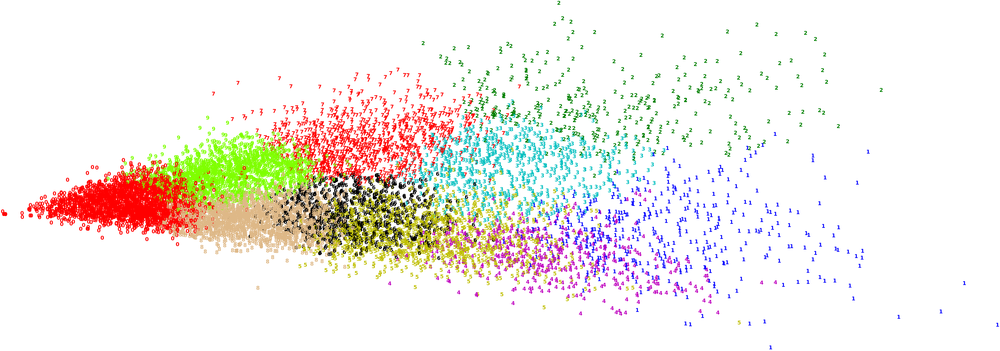

In [ ]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca_components.shape[0]):
    plt.text(pca_components[i, 0], pca_components[i, 1], str(y[i]),
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

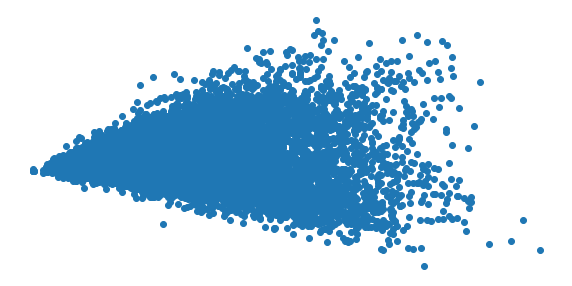

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_components[:, 0], pca_components[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

## Using t-SNE

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_std)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.045s...
[t-SNE] Computed neighbors for 10829 samples in 3.279s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.496720
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.060425
[t-SNE] KL

In [ ]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(tsne_results.shape[0]):
    plt.text(tsne_results[i, 0], tsne_results[i, 1], str(y[i]),
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

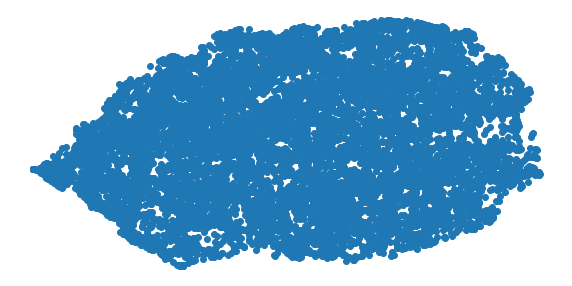

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Trying different **perplexity** Hyperparameter.

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.104s...
[t-SNE] Computed neighbors for 10829 samples in 2.029s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.369969
[t-SNE] KL divergence after 250 iterations with early exaggeration: 95.584686
[t-SNE] KL 

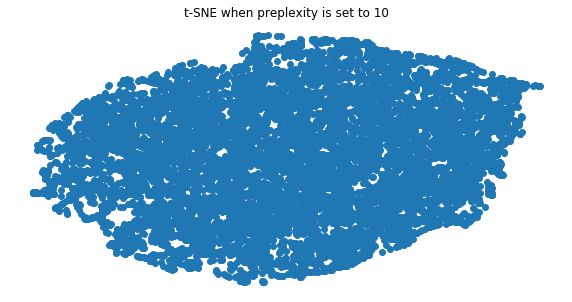

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.037s...
[t-SNE] Computed neighbors for 10829 samples in 2.882s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.432493
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.089027
[t-SNE] KL 

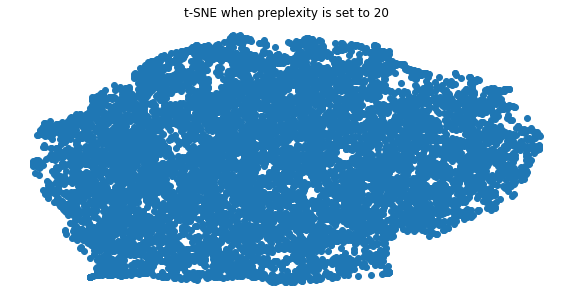

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.073s...
[t-SNE] Computed neighbors for 10829 samples in 2.813s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.469482
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.581238
[t-SNE] KL 

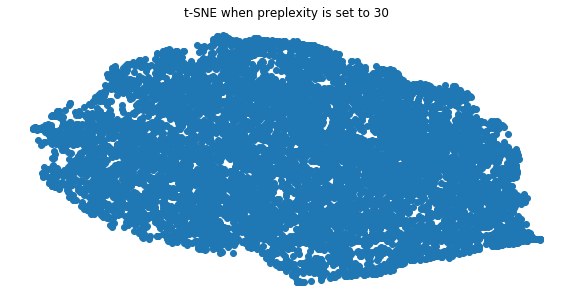

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.061s...
[t-SNE] Computed neighbors for 10829 samples in 3.083s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.518710
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.070335
[t-SNE] KL

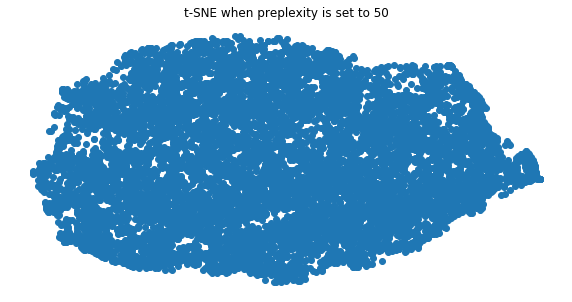

[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.049s...
[t-SNE] Computed neighbors for 10829 samples in 6.566s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.537387
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.426804
[t-SNE] KL

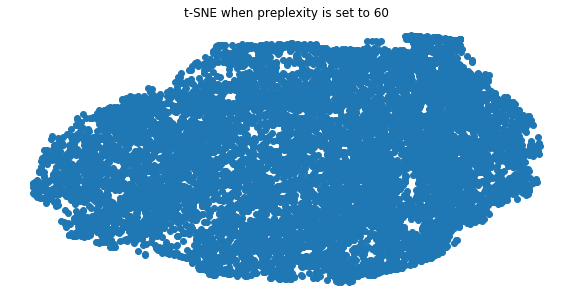

[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.060s...
[t-SNE] Computed neighbors for 10829 samples in 4.433s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.553768
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.039505
[t-SNE] KL

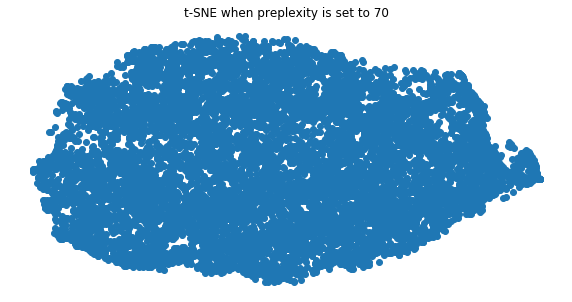

[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 10829 samples in 0.050s...
[t-SNE] Computed neighbors for 10829 samples in 3.916s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10829
[t-SNE] Computed conditional probabilities for sample 2000 / 10829
[t-SNE] Computed conditional probabilities for sample 3000 / 10829
[t-SNE] Computed conditional probabilities for sample 4000 / 10829
[t-SNE] Computed conditional probabilities for sample 5000 / 10829
[t-SNE] Computed conditional probabilities for sample 6000 / 10829
[t-SNE] Computed conditional probabilities for sample 7000 / 10829
[t-SNE] Computed conditional probabilities for sample 8000 / 10829
[t-SNE] Computed conditional probabilities for sample 9000 / 10829
[t-SNE] Computed conditional probabilities for sample 10000 / 10829
[t-SNE] Computed conditional probabilities for sample 10829 / 10829
[t-SNE] Mean sigma: 0.568451
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.828522
[t-SNE] KL

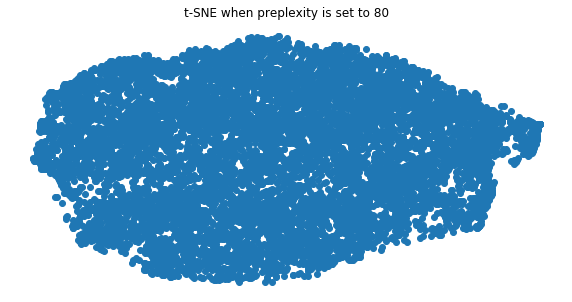

In [ ]:
perplexity_n = [10,20,30,50,60,70,80]

for n in perplexity_n:
    
    tsne = TSNE(n_components=2, verbose=1, perplexity=n, n_iter=300)
    tsne_results = tsne.fit_transform(X_std)
    
    plt.figure(figsize=(10,5))
    plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
    plt.xticks([])
    plt.yticks([])
    plt.title(f't-SNE when preplexity is set to {n}')
    plt.axis('off')
    plt.show()
    

## Using UMAP

In [ ]:
import umap
umap_results = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_std)

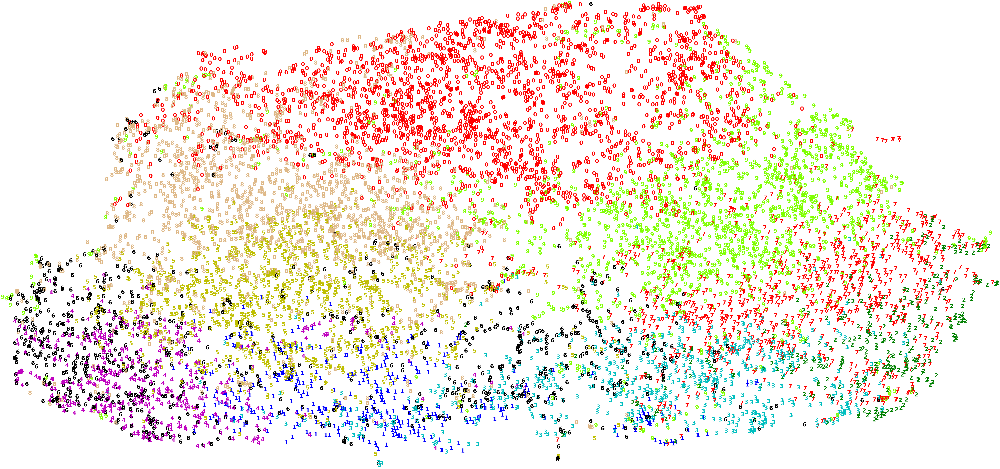

In [ ]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y[i],
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

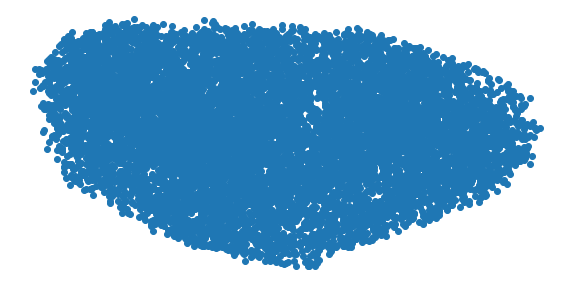

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

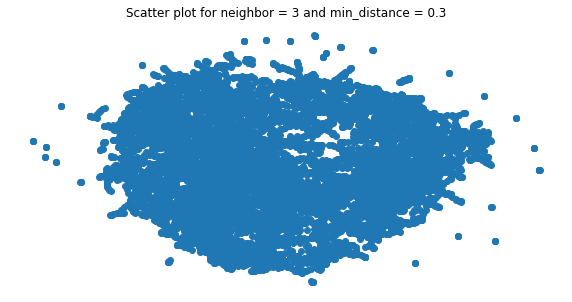

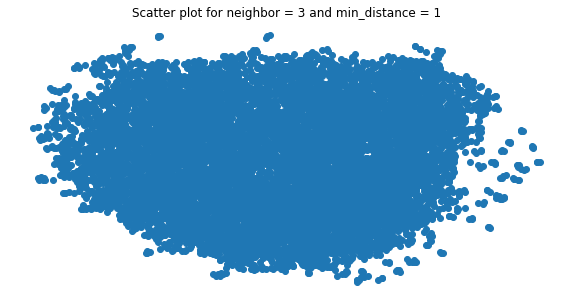

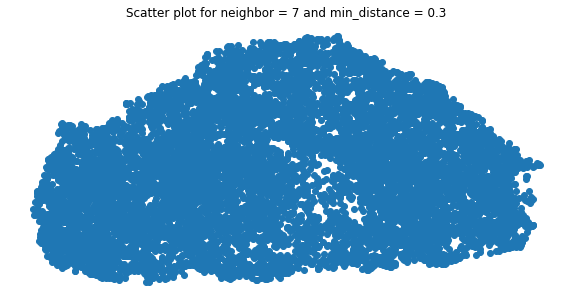

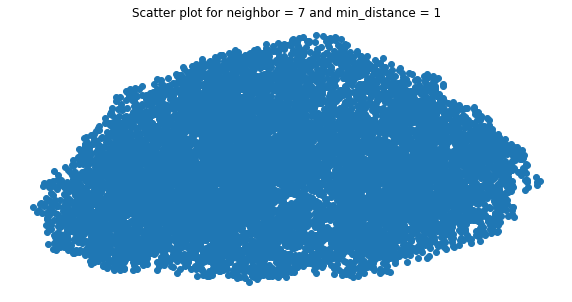

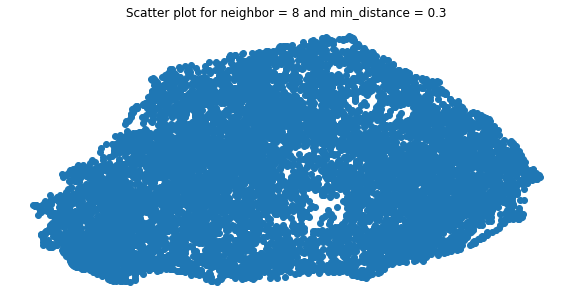

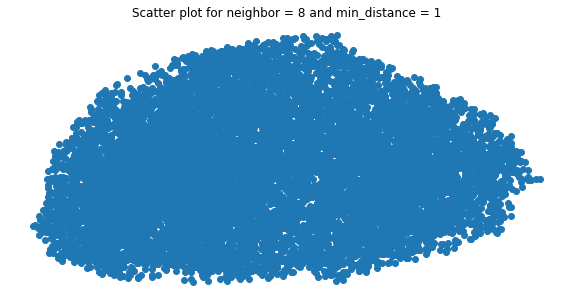

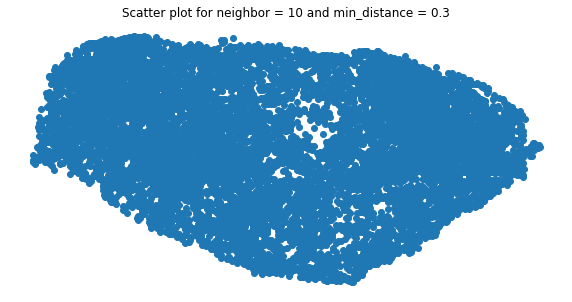

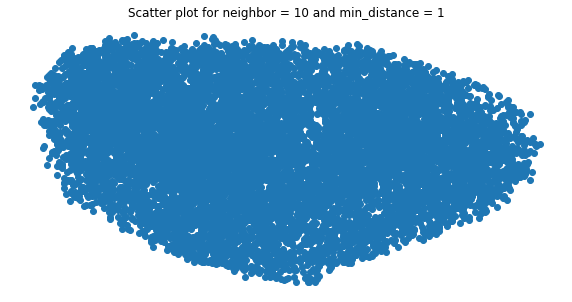

In [ ]:
neighbor_val = [3,7,8,10]
n_distance = [0.3, 1]

for n in neighbor_val:
    for i in n_distance:

        umap_results = umap.UMAP(n_neighbors=n,
                      min_dist=i,
                      metric='correlation').fit_transform(X_std)
          
        plt.figure(figsize=(10,5))
        plt.scatter(umap_results[:, 0], umap_results[:, 1])
        plt.xticks([])
        plt.yticks([])
        plt.axis('off')
        plt.title(f'Scatter plot for neighbor = {n} and min_distance = {i}')
        plt.show()

Using all Dimensionality techniques with different hyperparameters, it is still not easy to visualize the clusters using unlabeled and uncolored graphs.

# Apply clustering techniques to group similar observations.

## Using K-means

In [ ]:
# Defining the k-means
kmeans_cluster = KMeans(n_clusters=10, random_state=123)

# Fit model
%timeit kmeans_cluster.fit(X_std)
y_pred = kmeans_cluster.predict(X_std)

1.77 s ± 101 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


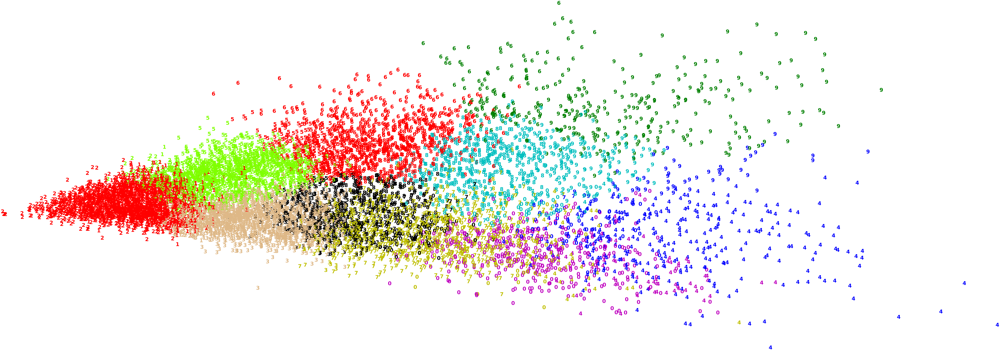

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(y_pred[i]),
             color=colours[y[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
# Get predicted clusters.
full_pred = KMeans(n_clusters=10, random_state=123).fit_predict(X_std)

In [ ]:
from sklearn import datasets, metrics
print("Adjusted Rand Index using K-means: {}".format(metrics.adjusted_rand_score(y, full_pred)))
print("The silhoutte score using K-means: {}".format(metrics.silhouette_score(X_std, full_pred, metric='euclidean')))

Adjusted Rand Index using K-means: 0.4723556782740616
The silhoutte score using K-means: 0.15277018897366312


## Using Hierarchical Clustering

In [ ]:
from sklearn.cluster import AgglomerativeClustering

# Defining the agglomerative clustering using complete linkage
agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='cosine',
                                      n_clusters=10)

# Fit model
clusters = agg_cluster.fit_predict(X_std)

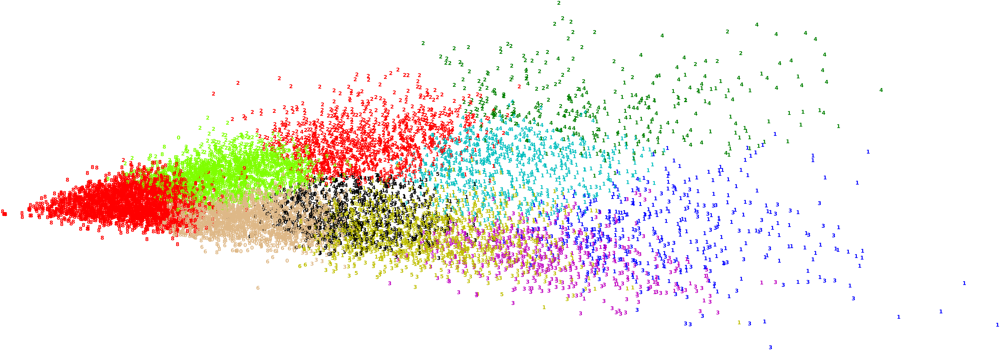

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[y[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
print("Adjusted Rand Index using Agglomerative Clustering w/ linkage complete: {}".format(metrics.adjusted_rand_score(y, clusters)))
print("The silhoutte score using Agglomerative Clustering w/ linkage complete: {}".format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

Adjusted Rand Index using Agglomerative Clustering w/ linkage complete: 0.33876280529949654
The silhoutte score using Agglomerative Clustering w/ linkage complete: 0.07219600009146523


In [ ]:
# Defining the agglomerative clustering using average linkage
agg_cluster_average = AgglomerativeClustering(linkage='average', 
                                      affinity='cosine',
                                      n_clusters=10)

# Fit model
clusters_average = agg_cluster_complete.fit_predict(X_std)

print("Adjusted Rand Index using Agglomerative Clustering w/ linkage average: {}".format(metrics.adjusted_rand_score(y, clusters_average)))
print("The silhoutte score using Agglomerative Clustering w/ linkage average: {}".format(metrics.silhouette_score(X_std, clusters_average, metric='euclidean')))

Adjusted Rand Index using Agglomerative Clustering w/ linkage average: 0.34070684899975295
The silhoutte score using Agglomerative Clustering w/ linkage average: 0.03862156681161379


In [ ]:
# Defining the agglomerative clustering using ward
agg_cluster_ward = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=10)

# Fit model
clusters_ward = agg_cluster_ward.fit_predict(X_std)

print("Adjusted Rand Index using Agglomerative Clustering w/ linkage ward: {}".format(metrics.adjusted_rand_score(y, clusters_ward)))
print("The silhoutte score using Agglomerative Clustering w/ linkage ward: {}".format(metrics.silhouette_score(X_std, clusters_ward, metric='euclidean')))

Adjusted Rand Index using Agglomerative Clustering w/ linkage ward: 0.4398928026644874
The silhoutte score using Agglomerative Clustering w/ linkage ward: 0.12411640529925973


## Using DBSCAN

In [ ]:
from sklearn.cluster import DBSCAN
# Defining the agglomerative clustering
dbscan_cluster = DBSCAN(eps=1, min_samples=5)

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

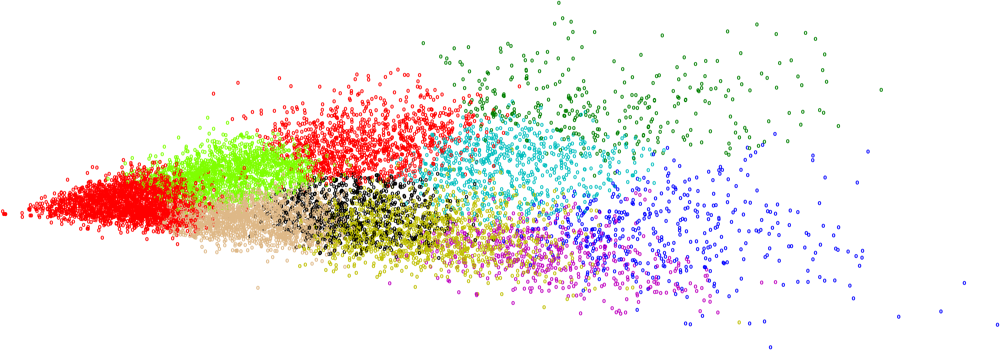

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[y[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
for i in range(2,20):
    dbscan_cluster = DBSCAN(eps=1, min_samples=i, metric="euclidean")
    # Fit model
    clusters = dbscan_cluster.fit_predict(X_std)
    print("Number of clusters when min_samples={} is: {}".format(i, len(np.unique(clusters))))

Number of clusters when min_samples=2 is: 386
Number of clusters when min_samples=3 is: 108
Number of clusters when min_samples=4 is: 33
Number of clusters when min_samples=5 is: 23
Number of clusters when min_samples=6 is: 10
Number of clusters when min_samples=7 is: 7
Number of clusters when min_samples=8 is: 8
Number of clusters when min_samples=9 is: 5
Number of clusters when min_samples=10 is: 3
Number of clusters when min_samples=11 is: 4
Number of clusters when min_samples=12 is: 4
Number of clusters when min_samples=13 is: 4
Number of clusters when min_samples=14 is: 2
Number of clusters when min_samples=15 is: 2
Number of clusters when min_samples=16 is: 2
Number of clusters when min_samples=17 is: 2
Number of clusters when min_samples=18 is: 2
Number of clusters when min_samples=19 is: 2


In [ ]:
dbscan_cluster = DBSCAN(eps=1, min_samples=6)

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

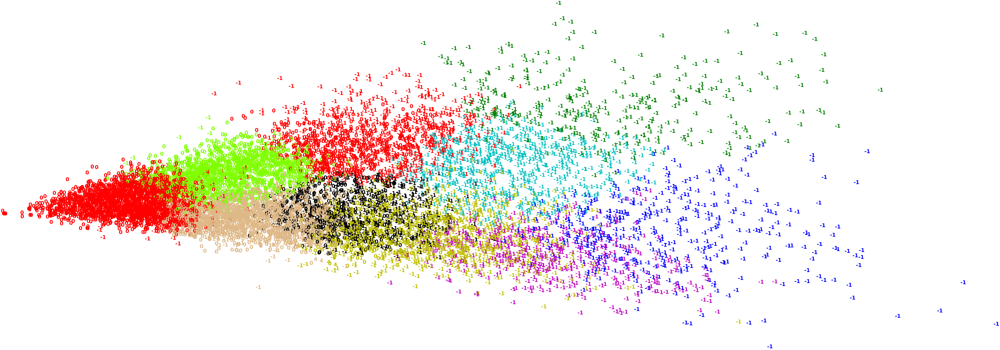

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[y[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
print("Adjusted Rand Index using DBSCAN: {}".format(metrics.adjusted_rand_score(y, clusters)))
print("The silhoutte score using DBSCAN: {}".format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

Adjusted Rand Index using DBSCAN: 0.15052833660190681
The silhoutte score using DBSCAN: -0.09022738462981801


## Gaussian

In [ ]:
from sklearn.mixture import GaussianMixture

gmm_cluster = GaussianMixture(n_components=10, random_state=123)

# Fit model
clusters = gmm_cluster.fit_predict(X_std)

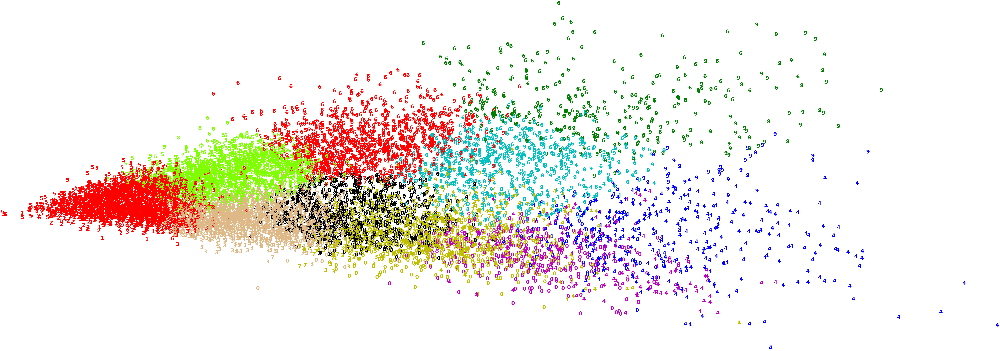

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[y[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
print("Adjusted Rand Index using GMM solution: {}".format(metrics.adjusted_rand_score(y, clusters)))
print("The silhoutte score using GMM solution: {}".format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

Adjusted Rand Index using GMM solution: 0.28558778494460935
The silhoutte score using GMM solution: 0.0012800691916465968


In [ ]:
covariance = ['full', 'tied', 'diag', 'spherical']

for i in covariance:
    
    gmm_cluster_type = GaussianMixture(n_components=10, random_state=123, covariance_type=i )

    # Fit model
    clusters_type = gmm_cluster_type.fit_predict(X_std)

    print("Adjusted Rand Index of the GMM {} solution: {}".format(i, metrics.adjusted_rand_score(y, clusters_type)))
    print("The silhoutte score of the GMM {} solution: {}".format(i, metrics.silhouette_score(X_std, clusters_type, metric='euclidean')))


Adjusted Rand Index of the GMM full solution: 0.28558778494460935
The silhoutte score of the GMM full solution: 0.0012800691916465968
Adjusted Rand Index of the GMM tied solution: 0.39922612576194616
The silhoutte score of the GMM tied solution: 0.18344461926193922
Adjusted Rand Index of the GMM diag solution: 0.34976099157560814
The silhoutte score of the GMM diag solution: 0.07447183412232511
Adjusted Rand Index of the GMM spherical solution: 0.3779688508174517
The silhoutte score of the GMM spherical solution: 0.11219609007616652


The Best Clustering 